<h1>Table of Contents<span class="tocSkip"></span></h1>

<div class="toc"><ul class="toc-item"><li><span><a href="#Initialization-and-preprocessing" data-toc-modified-id="Initialization-and-preprocessing-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Initialization and preprocessing</a></span></li>

<li><span><a href="#Term-Frequency-(TF)" data-toc-modified-id="Term-Frequency-(TF)-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Term Frequency (TF)</a></span></li>

<li><span><a href="#Inverse-Document-Frequency-(IDF)" data-toc-modified-id="Inverse-Document-Frequency-(IDF)-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Inverse Document Frequency (IDF)</a></span></li>

<li><span><a href="#Compute-TFIDF" data-toc-modified-id="Compute-TFIDF-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Compute TFIDF</a></span></li>

<li><span><a href="#Convert-to-sparse-matrix" data-toc-modified-id="Convert-to-sparse-matrix-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Convert to sparse matrix</a></span></li>

<li><span><a href="#Compare-our-matrix-with-Python-implementation" data-toc-modified-id="Compare-our-matrix-with-Python-implementation-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Compare our matrix with Python implementation</a></span></li>

<li><span><a href="#Build-a-bar-chart" data-toc-modified-id="Build-a-bar-chart"><span class="toc-item-num">7&nbsp;&nbsp;</span>Build a bar chart</a></span></li>

<li><span><a href="#Build-a-word-cloud" data-toc-modified-id="Build-a-word-cloud"><span class="toc-item-num">8&nbsp;&nbsp;</span>Build a word cloud</a></span></li></ul></div>

# TF/IDF from scratch

## Initialization and preprocessing
Let's take two sentences as an example

In [1]:
import pandas as pd
%matplotlib inline 

In [2]:
#Here you can also get a subset of your own dataset of comments
docA='I went skiing with my friends last weekend'
docB='My friends and I play poker every weekend'
doc=[docA, docB]
doc



['I went skiing with my friends last weekend',
 'My friends and I play poker every weekend']

In [2]:
doc = pd.read_csv('clean_data_gr4.csv')

Now, we tokenize all words of our corpus to build a dictionary and get rid of stopwords and punctuation

In [3]:
from nltk import word_tokenize
from string import punctuation
from nltk.corpus import stopwords

stopW = stopwords.words('french') + list(punctuation)
stopW += ['de','et','le','les','pour','à','très','nous','un','est','en','des','pas','dans','du','au','avec',',',"good", "great", "one", "nt", "u2013", "", "would", "get", "center", "parcs","the","le"
                   ," u00e0","nous","with","what","for","etait","not","the","une","de","pour","plus","zip","under","but","tr u00e0","   ",
                  'n\'t','...','\'ve','\'re', 'ã\x9dou', "''", 'avez','est','être','être.on','le','les','de','et','la','pour','très','à',
                'en','a','des','pas','dans','du','au','avec','sont','que','avons','de','et','pour'
                ,'nous','un','est','en','des','pas','dans','du','au','avec','-\\taqua','-\\ten','-\\tle','farfelues.moi','\\u2764','amp','dis','\\u00bc',
               'tré','tres','-\\tpas','-\\tla','1m01','cafetière\\u2026','une','tout','mais','qui','il','sur',"c'est",'ne','plus','ce','se',
               'aux','je','peu','vraiment','par','vous','fait','faire','était','car','ou','quot','si','sans','tous','aussi','fois','n','ans','entre','peut',
               'semaine','faut','voir','3','eu','cela','ont','nos','4','même','nos','contre','donc','surtour','son','reste','séjour','site','rapport',
                'surtout','quand','2','sommes','sinon','vu','jours','assez','autres','\u00e7a','ménage',"n'est",'toujours','soit','c','l','malgré','comme',
                'niveau','toutes','non','avions','toute','\u00e7a','mon','moins','passer','devant','où',"c est","trop"," u00e7a","parc","daims","cottage",
                   "sejour","etre","mundo","rien",'aqua',"bois","cottages","passe","l aqua","d activites","n'est","j'ai",'avant','apres','ils','alors',
                   'trouve','deja',"qu il",'dit','u0153uf']

In [5]:
doc

,Unnamed: 0,Unnamed: 0.1,hotel_name,published_date,rating,review,review_language,title,trip_date,tokens,Stemming,Lemmatisation
0,0,0,Center Parcs Le Bois aux Daims,1 février 2019,5,Premier séjour à center parc pour nous et nous...,fr,Petite semaine en famille,janvier 2019,"['premier', 'adore', 'partis', 'petite', 'fill...","['premier', 'sejour', 'center', 'parc', 'adore...","['premi', 'sejour', 'cent', 'parc', 'ador', 'p..."
1,1,1,Center Parcs Le Bois aux Daims,1 février 2019,5,sejour très agreable comme d habitude a center...,fr,center parcs la promesse des daims,janvier 2019,"['agreable', 'habitude', 'quel', 'plaisir', 't...","['sejour', 'tres', 'agreable', 'comme', 'habit...","['sejour', 'tre', 'agreabl', 'comm', 'habitud'..."
2,2,2,Center Parcs Le Bois aux Daims,1 février 2019,3,"Cottage très bien, propre et chaud dès l'arriv...",fr,A améliorer,janvier 2019,"['bien', 'propre', 'chaud', 'des', 'l arrivee'...","['cottage', 'tres', 'bien', 'propre', 'chaud',...","['cottag', 'tre', 'bien', 'propr', 'chaud', 'd..."
3,3,3,Center Parcs Le Bois aux Daims,1 février 2019,3,Séjour très reposant à noter tout de même troi...,fr,Reposant,février 2019,"['reposant', 'noter', 'trois', 'restaurants', ...","['sejour', 'tres', 'reposant', 'noter', 'trois...","['sejour', 'tre', 'repos', 'not', 'trois', 're..."
4,4,4,Center Parcs Le Bois aux Daims,2 février 2019,5,Arrivés pour trois nuits et deux jours en sema...,fr,tres belle decouverte,janvier 2019,"['arrives', 'trois', 'nuits', 'deux', 'hors', ...","['arrive', 'trois', 'nuits', 'deux', 'jours', ...","['arriv', 'trois', 'nuit', 'deux', 'jour', 'se..."
5,5,5,Center Parcs Le Bois aux Daims,30 janvier 2019,4,Center parc est un endroit très relaxant et en...,fr,Déconnexion,janvier 2019,"['endroit', 'relaxant', 'cohesion', 'nature', ...","['center', 'parc', 'endroit', 'tres', 'relaxan...","['cent', 'parc', 'endroit', 'tre', 'relax', 'c..."
6,6,6,Center Parcs Le Bois aux Daims,30 janvier 2019,5,agréablement surpris super séjour bien reposer...,fr,séjour agréable,janvier 2019,"['agreablement', 'surpris', 'super', 'bien', '...","['agreablement', 'surpris', 'super', 'sejour',...","['agreabl', 'surpr', 'sup', 'sejour', 'bien', ..."
7,7,7,Center Parcs Le Bois aux Daims,30 janvier 2019,2,Piscine bondée de monde !! Et pourtant hors pé...,fr,Piscine,janvier 2019,"['piscine', 'bondee', 'monde', 'pourtant', 'ho...","['piscine', 'bondee', 'monde', 'pourtant', 'ho...","['piscin', 'bonde', 'mond', 'pourt', 'hor', 'p..."
8,8,8,Center Parcs Le Bois aux Daims,31 janvier 2019,1,Le personnel du service client n'a pas été à l...,fr,Bof bof le service,novembre 2018,"['personnel', 'service', 'client', 'hauteur', ...","['personnel', 'service', 'client', 'hauteur', ...","['personnel', 'servic', 'client', 'hauteur', '..."
9,9,9,Center Parcs Le Bois aux Daims,31 janvier 2019,5,"Un vrai paradis pour déconnecter du travail, d...",fr,SUPER SEJOUR,janvier 2019,"['vrai', 'paradis', 'deconnecter', 'travail', ...","['vrai', 'paradis', 'deconnecter', 'travail', ...","['vrai', 'parad', 'deconnect', 'travail', 'ani..."


In [3]:
#import nltk #execute only if necesseray
#nltk.download('punkt') #execute only if necessary
doc

,Unnamed: 0,Unnamed: 0.1,hotel_name,published_date,rating,review,review_language,title,trip_date,tokens,Stemming,Lemmatisation
0,0,0,Center Parcs Le Bois aux Daims,1 février 2019,5,Premier séjour à center parc pour nous et nous...,fr,Petite semaine en famille,janvier 2019,"['premier', 'adore', 'partis', 'petite', 'fill...","['premier', 'sejour', 'center', 'parc', 'adore...","['premi', 'sejour', 'cent', 'parc', 'ador', 'p..."
1,1,1,Center Parcs Le Bois aux Daims,1 février 2019,5,sejour très agreable comme d habitude a center...,fr,center parcs la promesse des daims,janvier 2019,"['agreable', 'habitude', 'quel', 'plaisir', 't...","['sejour', 'tres', 'agreable', 'comme', 'habit...","['sejour', 'tre', 'agreabl', 'comm', 'habitud'..."
2,2,2,Center Parcs Le Bois aux Daims,1 février 2019,3,"Cottage très bien, propre et chaud dès l'arriv...",fr,A améliorer,janvier 2019,"['bien', 'propre', 'chaud', 'des', 'l arrivee'...","['cottage', 'tres', 'bien', 'propre', 'chaud',...","['cottag', 'tre', 'bien', 'propr', 'chaud', 'd..."
3,3,3,Center Parcs Le Bois aux Daims,1 février 2019,3,Séjour très reposant à noter tout de même troi...,fr,Reposant,février 2019,"['reposant', 'noter', 'trois', 'restaurants', ...","['sejour', 'tres', 'reposant', 'noter', 'trois...","['sejour', 'tre', 'repos', 'not', 'trois', 're..."
4,4,4,Center Parcs Le Bois aux Daims,2 février 2019,5,Arrivés pour trois nuits et deux jours en sema...,fr,tres belle decouverte,janvier 2019,"['arrives', 'trois', 'nuits', 'deux', 'hors', ...","['arrive', 'trois', 'nuits', 'deux', 'jours', ...","['arriv', 'trois', 'nuit', 'deux', 'jour', 'se..."
5,5,5,Center Parcs Le Bois aux Daims,30 janvier 2019,4,Center parc est un endroit très relaxant et en...,fr,Déconnexion,janvier 2019,"['endroit', 'relaxant', 'cohesion', 'nature', ...","['center', 'parc', 'endroit', 'tres', 'relaxan...","['cent', 'parc', 'endroit', 'tre', 'relax', 'c..."
6,6,6,Center Parcs Le Bois aux Daims,30 janvier 2019,5,agréablement surpris super séjour bien reposer...,fr,séjour agréable,janvier 2019,"['agreablement', 'surpris', 'super', 'bien', '...","['agreablement', 'surpris', 'super', 'sejour',...","['agreabl', 'surpr', 'sup', 'sejour', 'bien', ..."
7,7,7,Center Parcs Le Bois aux Daims,30 janvier 2019,2,Piscine bondée de monde !! Et pourtant hors pé...,fr,Piscine,janvier 2019,"['piscine', 'bondee', 'monde', 'pourtant', 'ho...","['piscine', 'bondee', 'monde', 'pourtant', 'ho...","['piscin', 'bonde', 'mond', 'pourt', 'hor', 'p..."
8,8,8,Center Parcs Le Bois aux Daims,31 janvier 2019,1,Le personnel du service client n'a pas été à l...,fr,Bof bof le service,novembre 2018,"['personnel', 'service', 'client', 'hauteur', ...","['personnel', 'service', 'client', 'hauteur', ...","['personnel', 'servic', 'client', 'hauteur', '..."
9,9,9,Center Parcs Le Bois aux Daims,31 janvier 2019,5,"Un vrai paradis pour déconnecter du travail, d...",fr,SUPER SEJOUR,janvier 2019,"['vrai', 'paradis', 'deconnecter', 'travail', ...","['vrai', 'paradis', 'deconnecter', 'travail', ...","['vrai', 'parad', 'deconnect', 'travail', 'ani..."


tried to clean the reviews directly instead of doing it only for the tokens 

all_reviews = doc.review.tolist()

#Lower caps:
lower_reviews = [review.lower() for review in all_reviews]

# deleting all specific caracters
characters_to_remove = ["@", "/", "#", ".", ",", "!", "?", "(", ")", "-", "_","’","'", "\"", ":",'\u2019t','\\u00c0']
transformation_dict = {initial:" " for initial in characters_to_remove}
no_punctuation_reviews = [review.translate(str.maketrans(transformation_dict)) for review in lower_reviews]

# removing accent
with_accent = ['é', 'è', 'à','ù','ï','ö','û','ê','ü','î']
without_accent = ['e', 'e', 'a','u','i','o','u','e','u','i']
transformation_dict = {before:after for before, after in zip(with_accent, without_accent)}
no_accent_reviews = [review.translate(str.maketrans(transformation_dict)) for review in no_punctuation_reviews]

# Displaying some results 
for i in range(5):
    print(all_reviews[i])
    print(no_accent_reviews[i])
    print('\n')

In [5]:
bag_of_words = [word_tokenize(text.lower()) for text in doc['review']]

In [8]:
for i, sent in enumerate(bag_of_words):
    bag_of_words[i] = [w for w in bag_of_words[i] if w not in stopW]

Get all unique words of the corpus

In [10]:
wordSet = set().union(*bag_of_words)
wordSet

{"'populas",
 "'milieu",
 "'complexe",
 "'toile",
 "'appreciablelocation",
 "'obliges",
 'ors',
 "'excessifs",
 "'2019",
 "'excellent",
 "'qque",
 "'venait",
 "'sil",
 "'precipitation",
 "'entrainer",
 "'remonte",
 'etage',
 "'entretien",
 "'pont",
 "'emportez",
 "'labyrinthe",
 "'utilises",
 "'frustrant",
 "'toussaint",
 "'effrayants",
 "'antivol",
 'entretien',
 "'permis",
 "'responsables",
 "'premature",
 'u00abbuffet',
 "'moitienous",
 "'maillots",
 "'tir",
 "'public",
 "'expliquant",
 "'paysan",
 "'rdv",
 'lieux',
 "'tardives",
 'août',
 "'aspirante",
 "'nuitee",
 "'grillee",
 "'blaireaux",
 'ory',
 "'finissons",
 "'qualitee",
 "'maniere",
 "'faisions",
 "'sante",
 "'courant",
 "'babmington",
 "'quatre",
 "'finis",
 "'store",
 "'pouvant",
 "'souffrent",
 "'depot",
 "'1m15",
 "'vont",
 'ude2cnous',
 "'valait",
 'etendue',
 "'animations",
 'oeil',
 "'aggreable",
 "'caracteres",
 "'satisfaits",
 'u0153ur',
 "'lien",
 "'taxes",
 "'samu",
 "'citer",
 "'defait",
 'italienne',
 "'couple"

Now, we create a list with one dictionary for each review, containing all words of the corpus

In [11]:
wordDict = []

for i in range(len(bag_of_words)):
    wordDict.append(dict.fromkeys(wordSet, 0))

If a review countains a word, we're adding 1 to its count

In [13]:
for i, sent in enumerate(bag_of_words):  ### ENUMERATE DOESN'T WORK! SO NOTHING IS ADDED TO EACH WORD
    for word in sent:
        wordDict[i][word]+=1

In [14]:
wordDict

[{"'populas": 0,
  "'milieu": 0,
  "'complexe": 0,
  "'toile": 0,
  "'appreciablelocation": 0,
  "'obliges": 0,
  'ors': 0,
  "'excessifs": 0,
  "'2019": 0,
  "'excellent": 0,
  "'qque": 0,
  "'venait": 0,
  "'sil": 0,
  "'precipitation": 0,
  "'entrainer": 0,
  "'remonte": 0,
  'etage': 0,
  "'entretien": 0,
  "'pont": 0,
  "'emportez": 0,
  "'labyrinthe": 0,
  "'utilises": 0,
  "'frustrant": 0,
  "'toussaint": 0,
  "'effrayants": 0,
  "'antivol": 0,
  'entretien': 0,
  "'permis": 0,
  "'responsables": 0,
  "'premature": 0,
  'u00abbuffet': 0,
  "'moitienous": 0,
  "'maillots": 0,
  "'tir": 0,
  "'public": 0,
  "'expliquant": 0,
  "'paysan": 0,
  "'rdv": 0,
  'lieux': 0,
  "'tardives": 0,
  'août': 0,
  "'aspirante": 0,
  "'nuitee": 0,
  "'grillee": 0,
  "'blaireaux": 0,
  'ory': 0,
  "'finissons": 0,
  "'qualitee": 0,
  "'maniere": 0,
  "'faisions": 0,
  "'sante": 0,
  "'courant": 0,
  "'babmington": 0,
  "'quatre": 0,
  "'finis": 0,
  "'store": 0,
  "'pouvant": 0,
  "'souffrent": 0,

We have our Document Term Matrix

In [27]:
df = pd.DataFrame(wordDict)
df.head()

,'',''le,''les,'aquamundo,'avez,'confort,'environnement,'espace,'est,'grand,...,évitez,évité,évoluer,évoluées,évoquées,événement,événements,être,être.beaucoup,être.on
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


We build a bar plot

In [14]:
df_mean = df.mean().sort_values(ascending=False).to_frame(name='occurence mean')

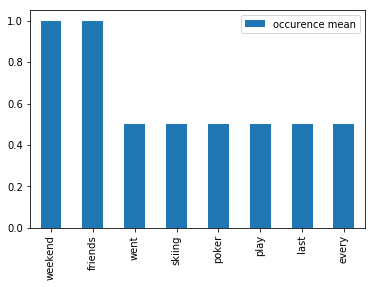

In [15]:
df_mean[:8].plot.bar()

## Term Frequency (TF)

Here instead of using a raw count, let's try a term frequency adjusted for document length

In [16]:
def compute_TF(wordDict, bow):
    tfDict = {}
    bowCount = len(bow)
    for word, count in wordDict.items():
        tfDict[word] = count/float(bowCount)
    return tfDict

In [17]:
tfBow = []
for i in range(len(bag_of_words)):
    tfBow.append(compute_TF(wordDict[i], bag_of_words[i]))

In [18]:
tfBow

[{'last': 0.2,
  'play': 0.0,
  'skiing': 0.2,
  'every': 0.0,
  'weekend': 0.2,
  'poker': 0.0,
  'went': 0.2,
  'friends': 0.2},
 {'last': 0.0,
  'play': 0.2,
  'skiing': 0.0,
  'every': 0.2,
  'weekend': 0.2,
  'poker': 0.2,
  'went': 0.0,
  'friends': 0.2}]

## Inverse Document Frequency (IDF)

In [19]:
import math
def compute_IDF(wordDict):
    idfDict = {}
    N = len(wordDict)
    idfDict = dict.fromkeys(wordDict[0].keys(), 0)
    for doc in wordDict:
        for word, val in doc.items():
            if val > 0:
                idfDict[word] += 1 #if the word is in the document
    for word, val in idfDict.items():
        idfDict[word] = math.log10(N / float(val))
    return idfDict
idfs = compute_IDF(wordDict)

In [20]:
idfs = compute_IDF(wordDict)

In [21]:
idfs

{'last': 0.3010299956639812,
 'play': 0.3010299956639812,
 'skiing': 0.3010299956639812,
 'every': 0.3010299956639812,
 'weekend': 0.0,
 'poker': 0.3010299956639812,
 'went': 0.3010299956639812,
 'friends': 0.0}

## Compute TFIDF

In [22]:
def compute_TFIDF(tfBow, idfs):
    tfidf = {}
    for word, val in tfBow.items():
        tfidf[word] = val*idfs[word]
    return tfidf

In [23]:
tfidf = []
for i in range(len(tfBow)):
    tfidf.append(compute_TFIDF(tfBow[i], idfs))

In [24]:
tfidf = pd.DataFrame(tfidf)
tfidf.head()

,every,friends,last,play,poker,skiing,weekend,went
0,0.000000,0.0,0.060206,0.000000,0.000000,0.060206,0.0,0.060206
1,0.060206,0.0,0.000000,0.060206,0.060206,0.000000,0.0,0.000000


In [25]:
print('A few words with lowest tfidf\n\n',tfidf.apply(sum).sort_values()[:5])
print('\n\nWords with largest tfidf\n\n',tfidf.apply(sum).sort_values()[-5:])

A few words with lowest tfidf

 friends    0.000000
weekend    0.000000
every      0.060206
last       0.060206
play       0.060206
dtype: float64


Words with largest tfidf

 last      0.060206
play      0.060206
poker     0.060206
skiing    0.060206
went      0.060206
dtype: float64


## Compare our matrix with Python implementation

In [26]:
#Here you can also get a subset of your own dataset of comments
#docA='I went skiing with my friends last weekend'
#docB='My friends and I play poker every weekend'
#doc=[docA, docB]
df = pd.read_csv('clean_data_group_4.csv')
doc = df['review']
doc.head()

0    Premier séjour à center parc pour nous et nous...
1    sejour très agreable comme d habitude a center...
2    Cottage très bien, propre et chaud dès l'arriv...
3    Séjour très reposant à noter tout de même troi...
4    Arrivés pour trois nuits et deux jours en sema...
Name: review, dtype: object

In [176]:
from string import punctuation
from nltk.corpus import stopwords

stopW = stopwords.words('english') + list(punctuation)
more_stopwords=['n\'t','...','\'ve','\'re', 'ã\x9dou', "''", 'avez','est','être','être.on','le','les','de','et','la','pour','très','à',
                'en','a','des','pas','dans','du','au','avec','sont','que','avons','de','et','pour'
                ,'nous','un','est','en','des','pas','dans','du','au','avec','-\\taqua','-\\ten','-\\tle','farfelues.moi','\\u2764','amp','dis','\\u00bc',
               'tré','tres','-\\tpas','-\\tla','1m01','cafetière\\u2026','une','tout','mais','qui','il','sur',"c'est",'ne','plus','ce','se',
               'aux','je','peu','vraiment','par','vous','fait','faire','était','car','ou','quot','si','sans','tous','aussi','fois','n','ans','entre','peut',
               'semaine','faut','voir','3','eu','cela','ont','nos','4','même','nos','contre','donc','surtour','son','reste','séjour','site','rapport',
                'surtout','quand','2','sommes','sinon','vu','jours','assez','autres','\u00e7a','ménage',"n'est",'toujours','soit','c','l','malgré','comme',
                'niveau','toutes','non','avions','toute','\u00e7a','mon','moins','passer','devant','où']

In [177]:
from sklearn.feature_extraction.text import TfidfVectorizer
from nltk import word_tokenize

vect = TfidfVectorizer(tokenizer=word_tokenize,stop_words=stopW+more_stopwords)
vect_transformed = vect.fit_transform(doc)

In [178]:
import numpy as np
feature_names = np.array(vect.get_feature_names())
sorted_tfidf_index = vect_transformed.max(0).toarray()[0].argsort()

print('Smallest tfidf:\n{}\n'.format(feature_names[sorted_tfidf_index[:10]]))
print('Largest tfidf: \n{}'.format(feature_names[sorted_tfidf_index[:-11:-1]]))

Smallest tfidf:
['arcade' "s'allument" '3/' '-10' 'emportez' 'sunparks' 'eemhof' 'précises'
 'malheureuses' '4,10\\u20ac/']

Largest tfidf: 
['flotte' 'bof' 'post' 'moitier' 'travailler' 'autour' 'mobilité' 'marche'
 'chèque' "l'absence"]


In [179]:
df_sklearn = pd.DataFrame(vect_transformed.todense(), columns = feature_names)
df_sklearn.head()

,''le,''les,'aquamundo,'avez,'confort,'environnement,'espace,'est,'grand,'impression,...,éviterma,évitez,évité,évoluer,évoluées,évoquées,événement,événements,êtes,être.beaucoup
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


They have similar values. Not exactly the same because the formulas used to comput the TF-IDF scores are different.

## Build a bar chart

In [180]:
df_sklearn_mean = df_sklearn.mean().sort_values(ascending=False).to_frame(name='tfidf mean')
df_sklearn_mean.head()

,tfidf mean
bien,0.035652
cottage,0.034677
parc,0.030887
enfants,0.026107
activités,0.025682


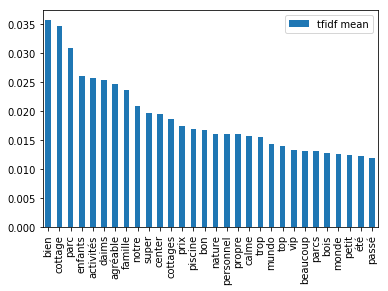

In [181]:
df_sklearn_mean[:30].plot.bar()

## Build a word cloud

In [182]:
from wordcloud import WordCloud
from PIL import Image
import matplotlib.pyplot as plt

In [183]:
dict_words_tfidf = df_sklearn_mean[df_sklearn_mean['tfidf mean'] != 0].to_dict()['tfidf mean']

In [184]:
#read mask (just for fun)
hotel_mask = np.array(Image.open("hotel.jpg"))

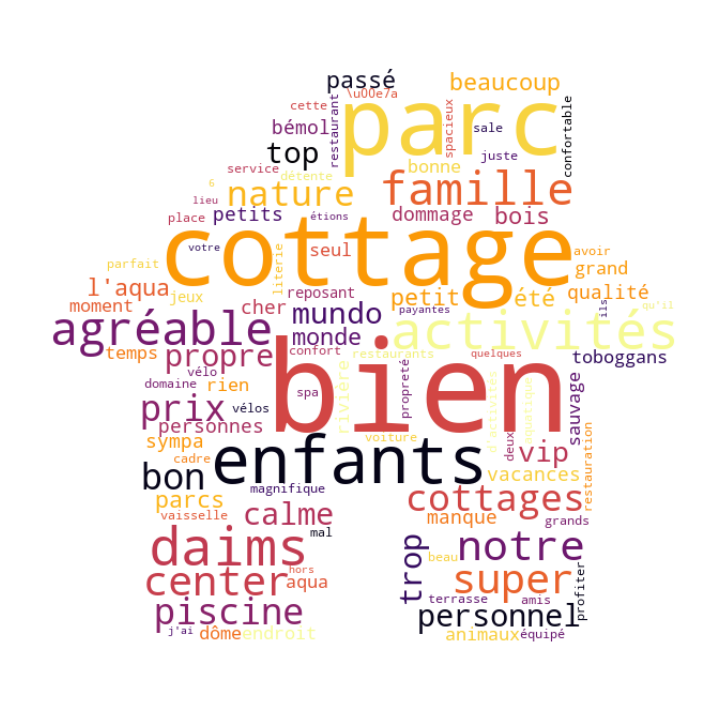

In [185]:
wordcloud = WordCloud(height=600, width=800, background_color="white", colormap='inferno', max_words=100, mask=hotel_mask)
wordcloud.generate_from_frequencies(frequencies=dict_words_tfidf)
plt.figure(figsize=(12,16))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

**Now it's your turn! Use your own datasets to get key insights about the main topics discussed in the reviews**